In [2]:
import tensorflow as tf
import os
import numpy as np
import pandas as pd
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Sequential
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, ZeroPadding2D,Flatten,Dense,Input,MaxPool2D,Conv2DTranspose
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'
gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=0.7)
sess = tf.Session(config=tf.ConfigProto(gpu_options=gpu_options))

### DATASET = http://www.fit.vutbr.cz/~vasicek/imagedb/

In [3]:
orig = []
noisy = []
dir_path = "noisyimg"

count = 1
for i in os.listdir(dir_path):
    p1 = os.path.join(dir_path,i)
    for j in (os.listdir(p1)):
        if j == '.ipynb_checkpoints' or i == '.ipynb_checkpoints':
            continue
        if p1 == 'noisyimg/original':
            orig.append(os.path.join(os.path.join(dir_path,i),j))
        else:
            noisy.append(os.path.join(os.path.join(dir_path,i),j))

len(orig)

24

In [19]:
noisy = np.sort(noisy)
orig = np.sort(orig)

original = []
for i in range(15):
    for j in orig:
        original.append(j)
original = np.array(original)

In [20]:
noisy = noisy[::-1]
original = original[::-1]

In [21]:
len(noisy)

360

In [23]:
count = 0
for i in range(len(noisy)):
    im = noisy[i].split('/')
    img = original[i].split('/')
    if(im[2] == img[2]):
        count += 1
print(count)

360


In [9]:
import cv2
data = []

for i in noisy:
    img = cv2.imread(i,0).reshape(256,384,1)
    img[img == 255] = 0
    data.append(img)
data = np.array(data)

label = []
for i in original:
    img = cv2.imread(i,0).reshape(256,384,1)
    label.append(img)
label = np.array(label)

In [10]:
ytrain = label[0:300]
xtrain = data[0:300]
ytest = label[300:360]
xtest = data[300:360]

In [11]:
from sklearn.metrics import roc_auc_score, f1_score

class loss(tf.keras.callbacks.Callback):
    def __init__(self,tr_data,tr_label, decay):
        self.x = tr_data
        self.y = tr_label
        self.decay = decay
        self.plr = -1
        
    def on_epoch_end(self, epoch, logs={}):
        y_pred = self.model.predict(self.x)
        roc = roc_auc_score(self.y, y_pred, average='macro')
        y_pred = convert(y_pred)
        f1 = f1_score(self.y, y_pred, average = 'macro')
        print('roc-score:', str(round(roc,4)),'f1-score:', str(round(f1,4)))
        
        modelWeights = []
        for layer in self.model.layers:
            layerWeights = []
            for weight in layer.get_weights():
            
                print("in weights", weight.shape, layer.name)
                if np.sum(np.isnan(weight)) != 0:
                    print("stopping train as we have na values in weights")
                    self.model.stop_training = True
                    print("stopping model")
        if np.isnan(logs['loss']):
            print("stopping train as we have na values in loss")
            self.model.stop_training = True
            print("stopping model")
        print('-'*30, "epoch", epoch, "is done", "-"*30)
        
        old_lr = tf.keras.backend.get_value(self.model.optimizer.lr)
        if logs['val_acc'] < self.plr:
            nlr = old_lr*0.9
            tf.keras.backend.set_value(self.model.optimizer.lr, nlr)
        self.plr = logs['val_acc']
        
    def on_epoch_begin(self,epoch,logs = {}):
        
        old_lr = tf.keras.backend.get_value(self.model.optimizer.lr)
        print("learning rate at this epoch: ",old_lr)
        if epoch > 1 and epoch%3 == 0 :
            new_lr = 0.95*old_lr
            tf.keras.backend.set_value(self.model.optimizer.lr, new_lr)
            print("modifying learning rate by a factor of 0.95, in next epoch your learning rate will be ", new_lr)
        else:
            tf.keras.backend.set_value(self.model.optimizer.lr, old_lr)

In [12]:

import os
import random as rn
os.environ['PYTHONHASHSEED'] = '0'

##https://keras.io/getting-started/faq/#how-can-i-obtain-reproducible-results-using-keras-during-development
## Have to clear the session. If you are not clearing, Graph will create again and again and graph size will increses. 
## Varibles will also set to some value from before session
tf.keras.backend.clear_session()

## Set the random seed values to regenerate the model.
np.random.seed(0)
#tf.random.set_seed(0)
tf.set_random_seed(0)
rn.seed(0)


input_layer = Input(shape=(256, 384,1))
Conv1 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation='relu',kernel_initializer=tf.keras.initializers.he_normal(seed=3),name='Conv1')(input_layer)
Conv2 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),name='Conv2')(Conv1)
batch_norm = tf.keras.layers.BatchNormalization()(Conv2)
relu_act1 = tf.keras.layers.ReLU()(batch_norm)

Conv3 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),
               kernel_regularizer= tf.contrib.layers.l2_regularizer(scale=0.01),name='Conv3')(relu_act1)
batch_norm = tf.keras.layers.BatchNormalization()(Conv3)
relu_act2 = tf.keras.layers.ReLU()(batch_norm)

Conv4 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),
               kernel_regularizer= tf.contrib.layers.l2_regularizer(scale=0.01),name='Conv4')(relu_act2)
batch_norm = tf.keras.layers.BatchNormalization()(Conv4)
relu_act3 = tf.keras.layers.ReLU()(batch_norm)

Conv5 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),name='Conv5')(relu_act3)
batch_norm = tf.keras.layers.BatchNormalization()(Conv5)
relu_act4 = tf.keras.layers.ReLU()(batch_norm)

Conv6 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),
               kernel_regularizer= tf.contrib.layers.l2_regularizer(scale=0.01),name='Conv6')(relu_act4)
batch_norm = tf.keras.layers.BatchNormalization()(Conv6)
relu_act5 = tf.keras.layers.ReLU()(batch_norm)

Conv7 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),
               kernel_regularizer= tf.contrib.layers.l2_regularizer(scale=0.01),name='Conv7')(relu_act5)
batch_norm = tf.keras.layers.BatchNormalization()(Conv7)
relu_act6 = tf.keras.layers.ReLU()(batch_norm)

Conv8 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),name='Conv8')(relu_act6)
batch_norm = tf.keras.layers.BatchNormalization()(Conv8)
relu_act7 = tf.keras.layers.ReLU()(batch_norm)

Conv9 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),
               kernel_regularizer= tf.contrib.layers.l2_regularizer(scale=0.01),name='Conv9')(relu_act7)
batch_norm = tf.keras.layers.BatchNormalization()(Conv9)
relu_act8 = tf.keras.layers.ReLU()(batch_norm)

Conv10 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),
                kernel_regularizer= tf.contrib.layers.l2_regularizer(scale=0.01),name='Conv10')(relu_act8)
batch_norm = tf.keras.layers.BatchNormalization()(Conv10)
relu_act9 = tf.keras.layers.ReLU()(batch_norm)

Conv11 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),name='Conv11')(relu_act9)
batch_norm = tf.keras.layers.BatchNormalization()(Conv11)
relu_act10 = tf.keras.layers.ReLU()(batch_norm)

Conv12 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),
                kernel_regularizer= tf.contrib.layers.l2_regularizer(scale=0.01),name='Conv12')(relu_act10)
batch_norm = tf.keras.layers.BatchNormalization()(Conv12)
relu_act11 = tf.keras.layers.ReLU()(batch_norm)

Conv13 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),name='Conv13')(relu_act11)
batch_norm = tf.keras.layers.BatchNormalization()(Conv13)
relu_act12 = tf.keras.layers.ReLU()(batch_norm)

Conv14 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),
                kernel_regularizer= tf.contrib.layers.l2_regularizer(scale=0.01),name='Conv14')(relu_act12)
batch_norm = tf.keras.layers.BatchNormalization()(Conv14)
relu_act13 = tf.keras.layers.ReLU()(batch_norm)

Conv15 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),name='Conv15')(relu_act13)
batch_norm = tf.keras.layers.BatchNormalization()(Conv15)
relu_act14 = tf.keras.layers.ReLU()(batch_norm)

Conv16 = Conv2D(filters=64,kernel_size=3,strides=1,padding='same',
              activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),
                kernel_regularizer= tf.contrib.layers.l2_regularizer(scale=0.01),name='Conv16')(relu_act14)
batch_norm = tf.keras.layers.BatchNormalization()(Conv16)
relu_act15 = tf.keras.layers.ReLU()(batch_norm)

Conv17 = Conv2D(filters=1,kernel_size=3,strides=1,padding='same',
        activation=None,kernel_initializer=tf.keras.initializers.he_normal(seed=3),
                kernel_regularizer= tf.contrib.layers.l2_regularizer(scale=0.01),name='Conv17')(relu_act15)


model6=Model(input_layer,Conv17)
model6.summary()

Instructions for updating:
Colocations handled automatically by placer.

For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
If you depend on functionality not listed there, please file an issue.

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 256, 384, 1)       0         
_________________________________________________________________
Conv1 (Conv2D)               (None, 256, 384, 64)      640       
_________________________________________________________________
Conv2 (Conv2D)               (None, 256, 384, 64)      36928     
_________________________________________________________________
batch_normalization_v1 (Batc (None, 256, 384, 64)      256       
_________________________________________________________________
re_lu (ReLU)                 (No

In [26]:
checkpoint_path = 'denoise.h5'
checkp = tf.keras.callbacks.ModelCheckpoint(checkpoint_path, verbose=1, save_best_only=True, monitor='val_loss')

model6.compile(optimizer=tf.keras.optimizers.Adam(0.001),loss='mean_squared_error')
model6.fit(xtrain,ytrain,epochs=20,validation_data=(xtest,ytest),batch_size=10,callbacks=[checkp])

Train on 300 samples, validate on 60 samples
Epoch 1/20
290/300 [============================>.] - ETA: 1s - loss: 229.8738
Epoch 00001: val_loss improved from inf to 382.60512, saving model to denoise.h5
300/300 [==============================] - 40s 134ms/sample - loss: 229.1760 - val_loss: 382.6051
Epoch 2/20
290/300 [============================>.] - ETA: 1s - loss: 237.8895
Epoch 00002: val_loss did not improve from 382.60512
300/300 [==============================] - 35s 116ms/sample - loss: 235.6193 - val_loss: 2939.5677
Epoch 3/20
290/300 [============================>.] - ETA: 1s - loss: 196.4048
Epoch 00003: val_loss did not improve from 382.60512
300/300 [==============================] - 35s 117ms/sample - loss: 195.3289 - val_loss: 961.2053
Epoch 4/20
290/300 [============================>.] - ETA: 1s - loss: 194.4583
Epoch 00004: val_loss did not improve from 382.60512
300/300 [==============================] - 35s 116ms/sample - loss: 197.1294 - val_loss: 592.7367
Epoch 

In [52]:
model6.load_weights('denoise.h5')

In [53]:
from matplotlib import pyplot as plt
import cv2
import math

def psnr(img1, img2):
    mse = np.mean( (img1 - img2) ** 2 )
    if mse == 0:
        return 100
    PIXEL_MAX = 255.0
    return 20 * math.log10(PIXEL_MAX / math.sqrt(mse))

PSNR:  29.57968681574071 

	noisy image				predicted				original


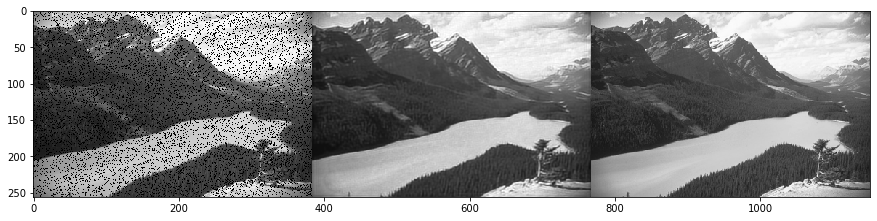

PSNR:  30.901232569873237 

	noisy image				predicted				original


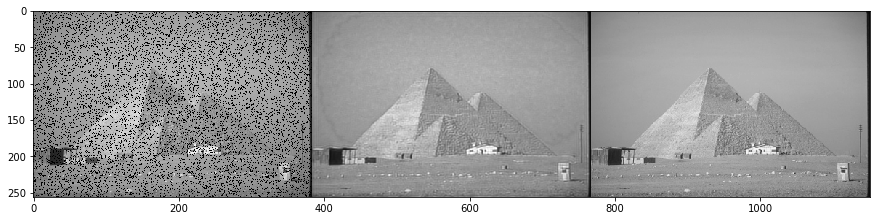

PSNR:  28.598410931055334 

	noisy image				predicted				original


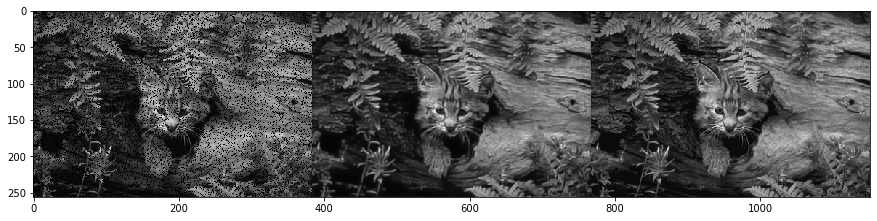

PSNR:  27.651684501289758 

	noisy image				predicted				original


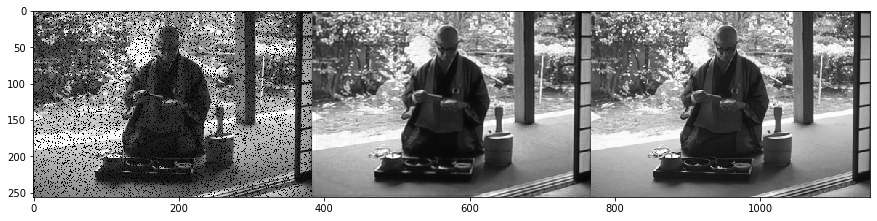

PSNR:  29.607581269391293 

	noisy image				predicted				original


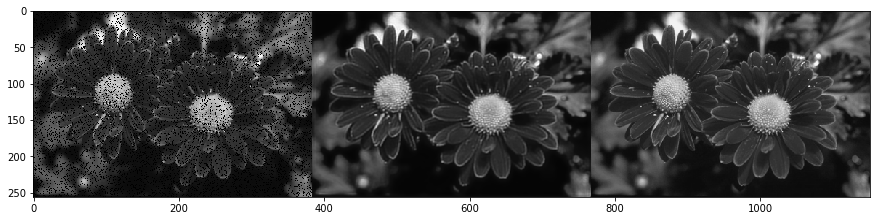

PSNR:  29.869868650366836 

	noisy image				predicted				original


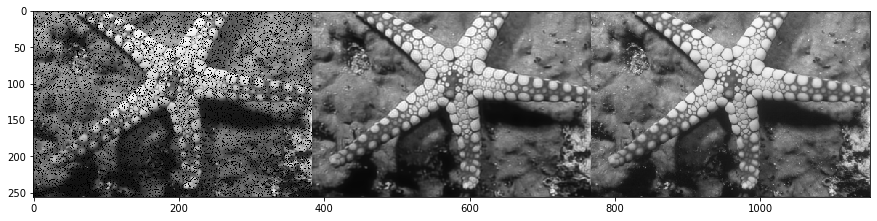

PSNR:  30.841802728761365 

	noisy image				predicted				original


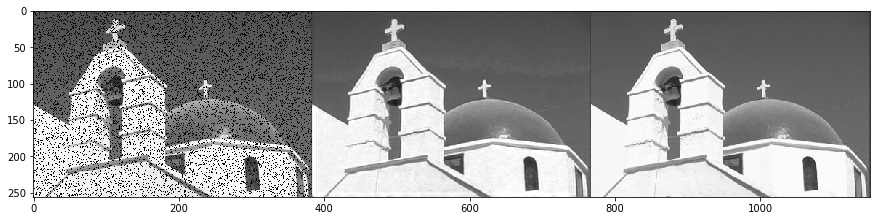

PSNR:  28.07802467470688 

	noisy image				predicted				original


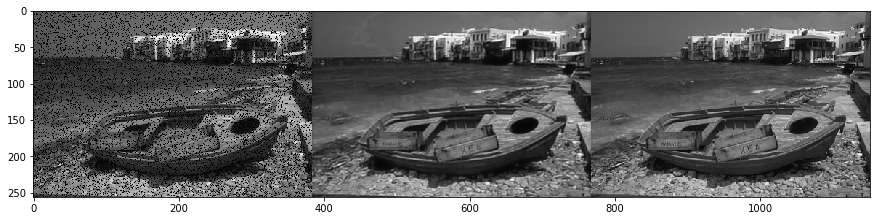

PSNR:  28.091999592224166 

	noisy image				predicted				original


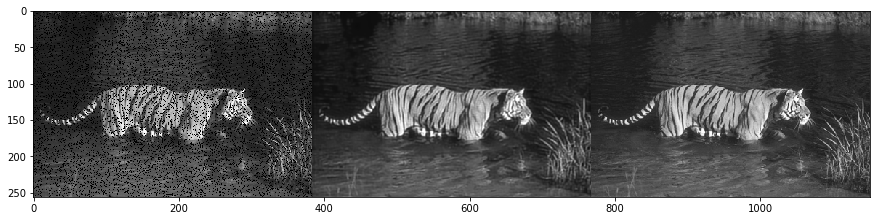

PSNR:  30.210846165303625 

	noisy image				predicted				original


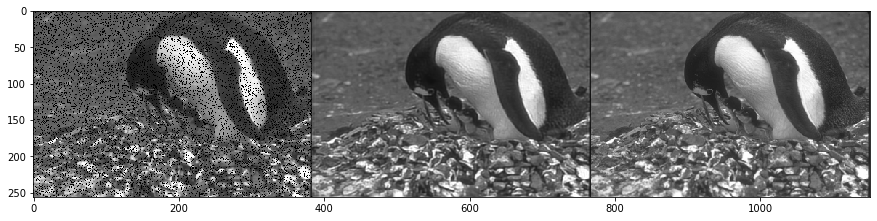

PSNR:  32.95923319101156 

	noisy image				predicted				original


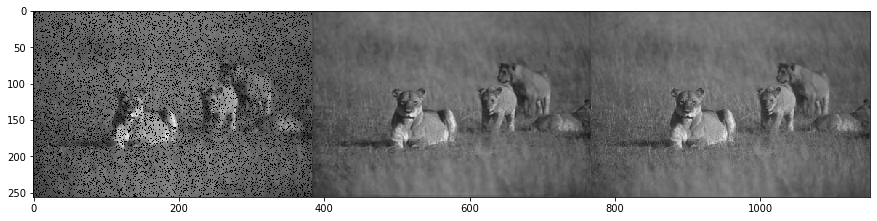

PSNR:  26.824950919465493 

	noisy image				predicted				original


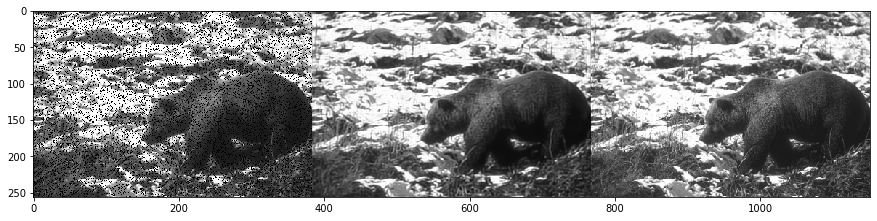

PSNR:  29.33642569408815 

	noisy image				predicted				original


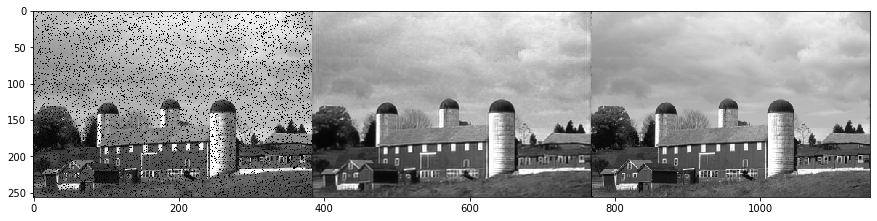

PSNR:  28.51145540502026 

	noisy image				predicted				original


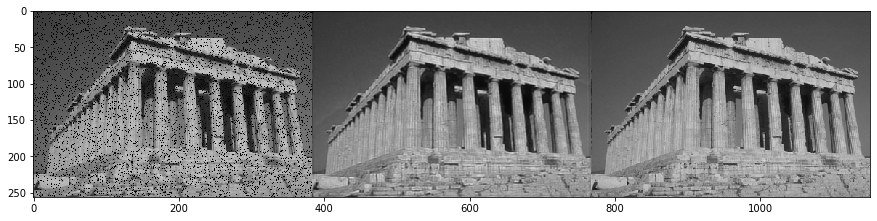

PSNR:  28.15759609495028 

	noisy image				predicted				original


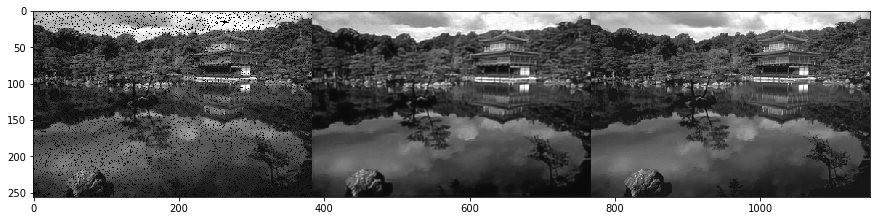

PSNR:  27.867297179430103 

	noisy image				predicted				original


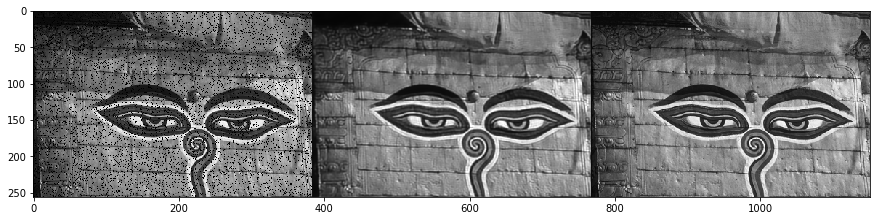

PSNR:  27.857574789294514 

	noisy image				predicted				original


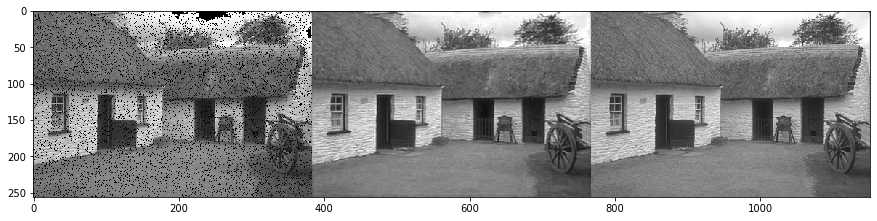

PSNR:  29.94187696063571 

	noisy image				predicted				original


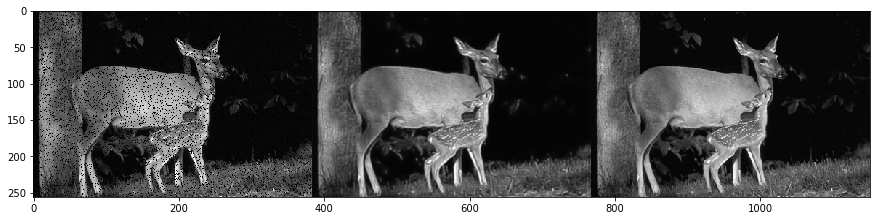

PSNR:  33.331701592340536 

	noisy image				predicted				original


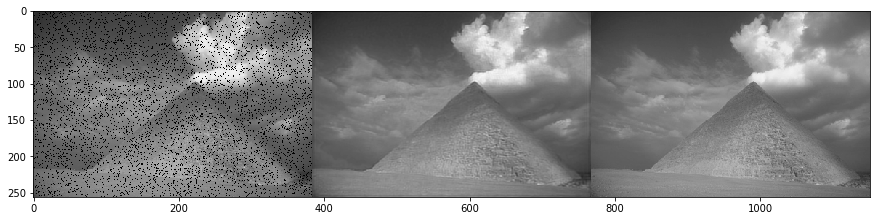

PSNR:  33.6266404596378 

	noisy image				predicted				original


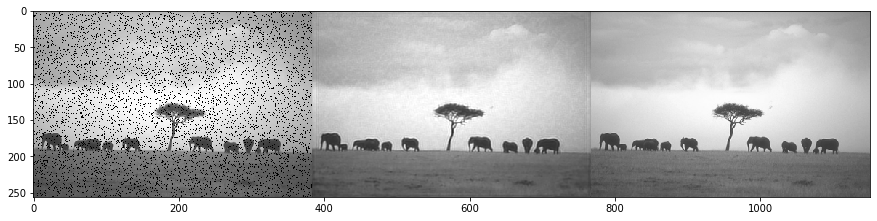

PSNR:  30.97912415672715 

	noisy image				predicted				original


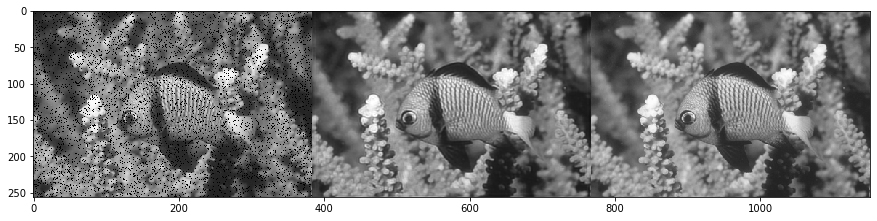

PSNR:  30.373673177759027 

	noisy image				predicted				original


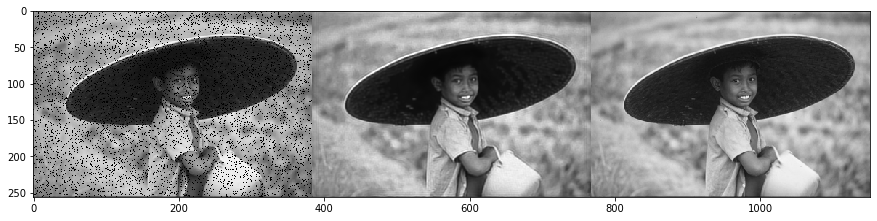

PSNR:  27.666764393404236 

	noisy image				predicted				original


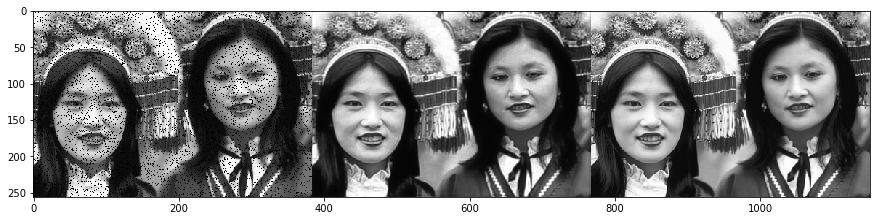

PSNR:  27.90265648127597 

	noisy image				predicted				original


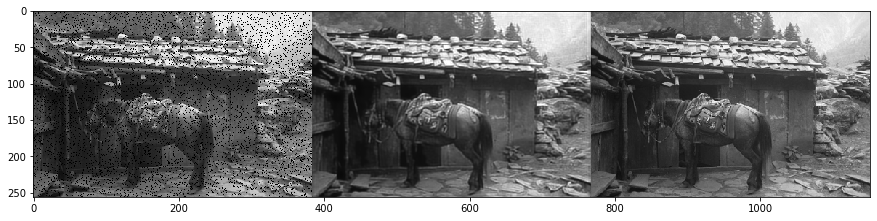

PSNR:  29.6077335019389 

	noisy image				predicted				original


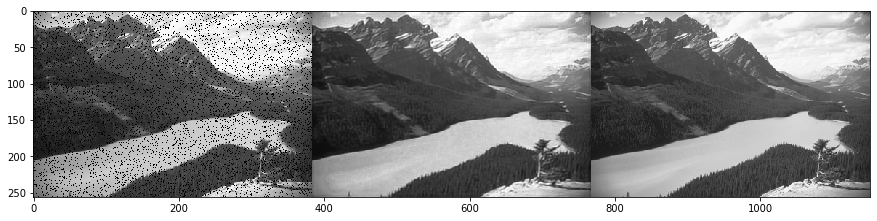

PSNR:  31.598640182871076 

	noisy image				predicted				original


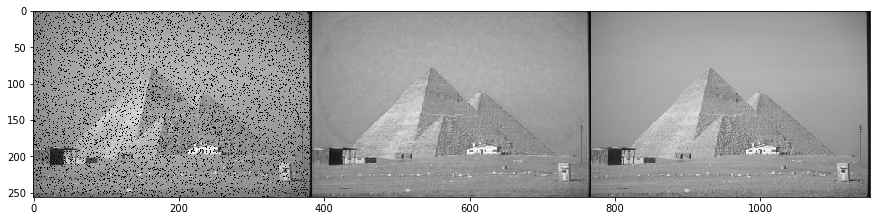

PSNR:  28.597017044674892 

	noisy image				predicted				original


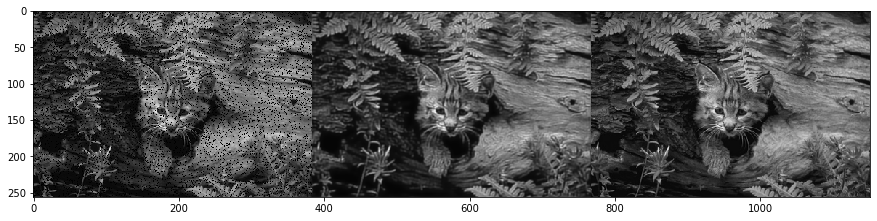

PSNR:  27.633916462401512 

	noisy image				predicted				original


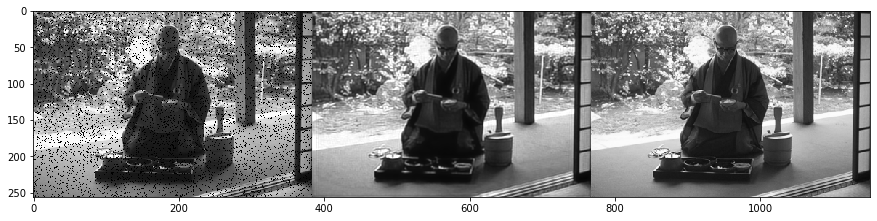

PSNR:  29.24656121238661 

	noisy image				predicted				original


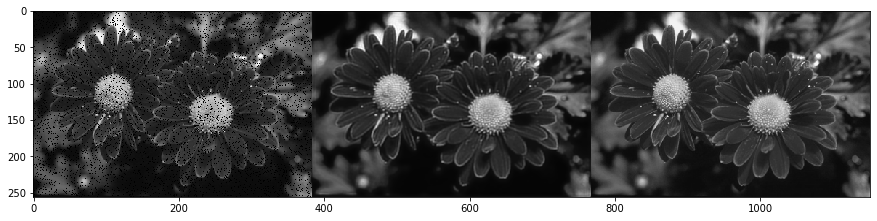

PSNR:  29.757644296322002 

	noisy image				predicted				original


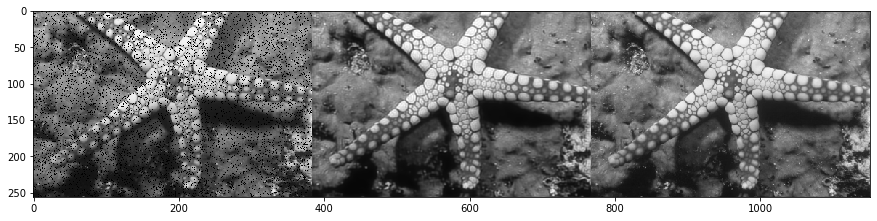

PSNR:  30.962733369275686 

	noisy image				predicted				original


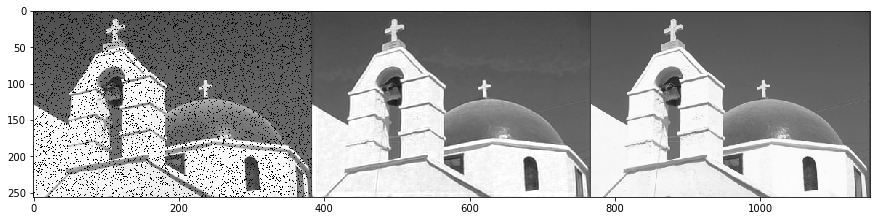

PSNR:  28.111410214862424 

	noisy image				predicted				original


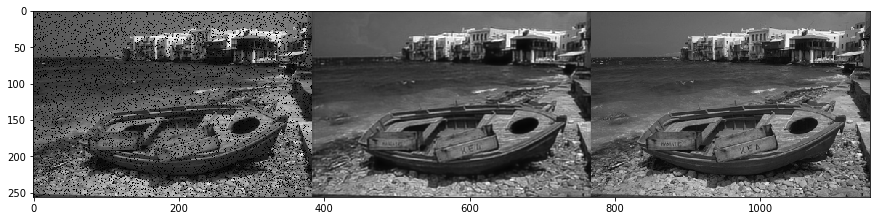

PSNR:  27.827911723049155 

	noisy image				predicted				original


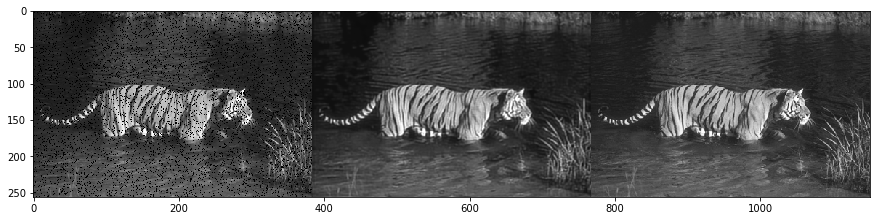

PSNR:  30.195001191936637 

	noisy image				predicted				original


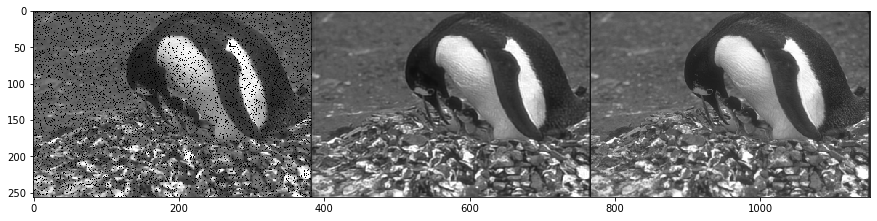

PSNR:  33.304886224728534 

	noisy image				predicted				original


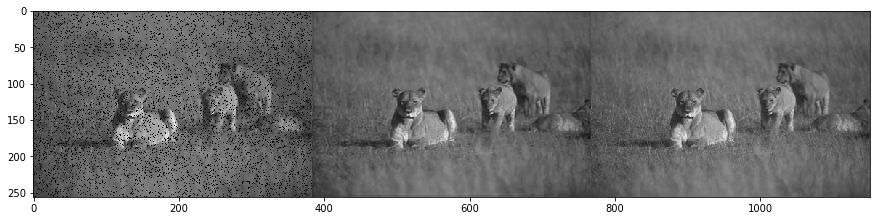

PSNR:  26.777060560280844 

	noisy image				predicted				original


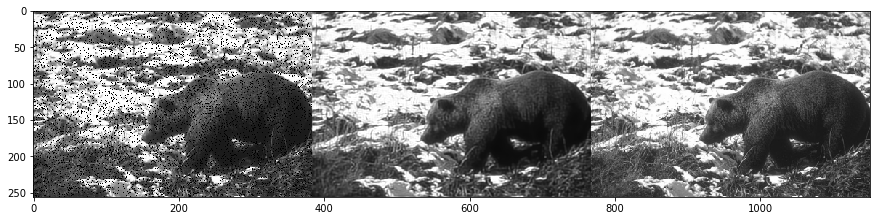

PSNR:  29.439524884673176 

	noisy image				predicted				original


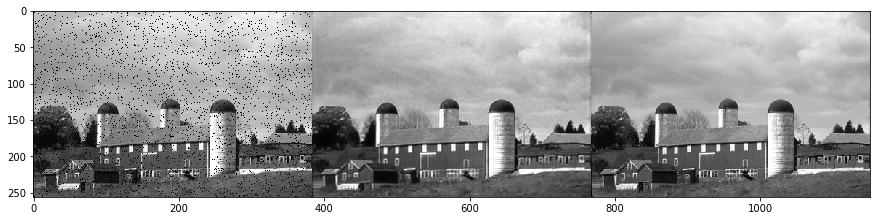

PSNR:  28.758142687054487 

	noisy image				predicted				original


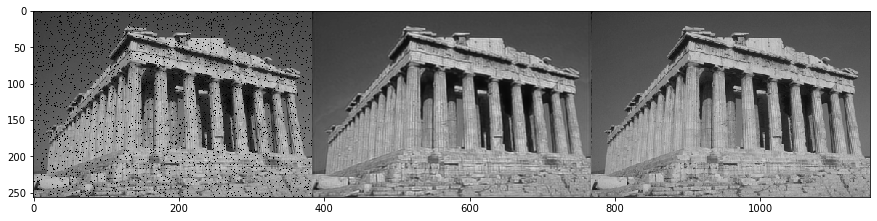

PSNR:  27.953535448441038 

	noisy image				predicted				original


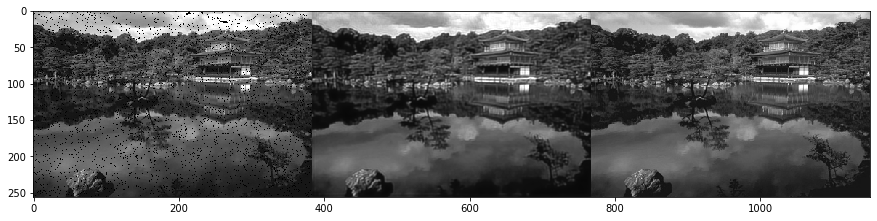

PSNR:  27.883117242192235 

	noisy image				predicted				original


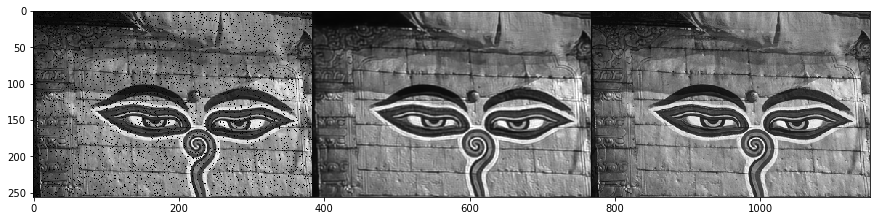

PSNR:  27.84097969186041 

	noisy image				predicted				original


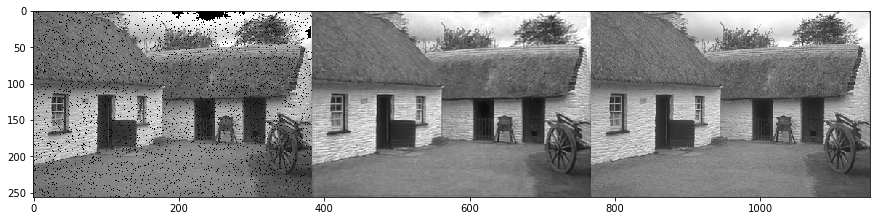

PSNR:  30.022616328285036 

	noisy image				predicted				original


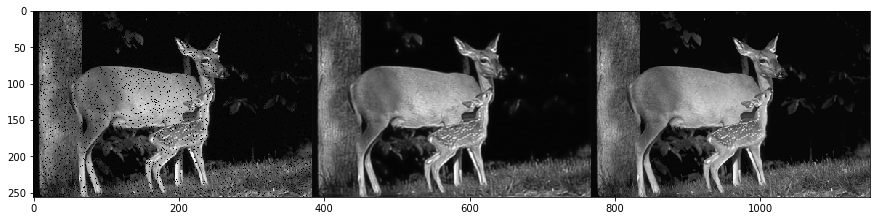

PSNR:  33.907731000241455 

	noisy image				predicted				original


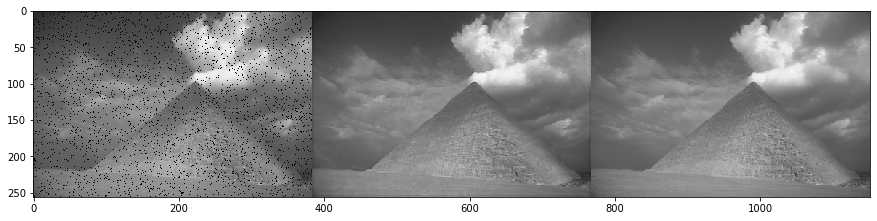

PSNR:  34.122420359037655 

	noisy image				predicted				original


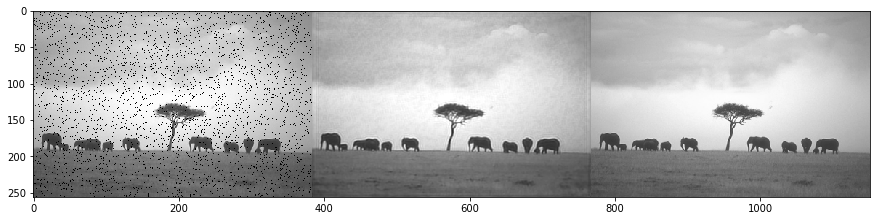

PSNR:  31.050853997970673 

	noisy image				predicted				original


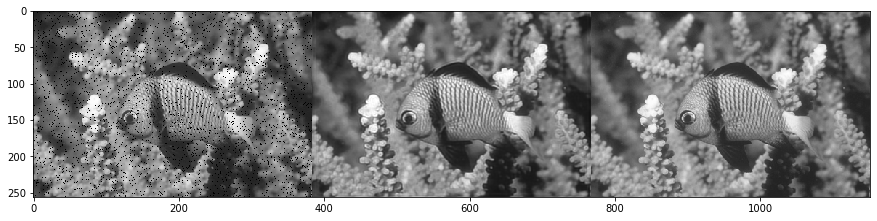

PSNR:  30.04925281399033 

	noisy image				predicted				original


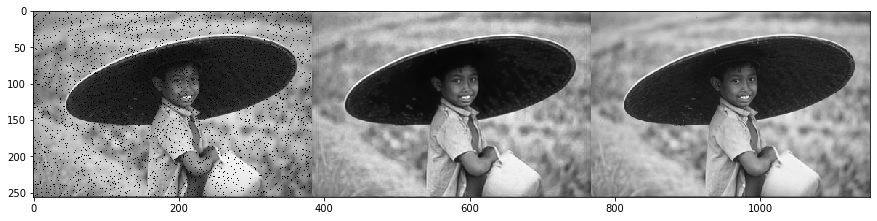

PSNR:  27.581622472201296 

	noisy image				predicted				original


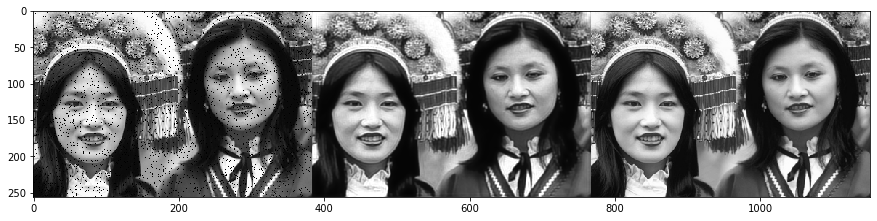

PSNR:  27.61100158822595 

	noisy image				predicted				original


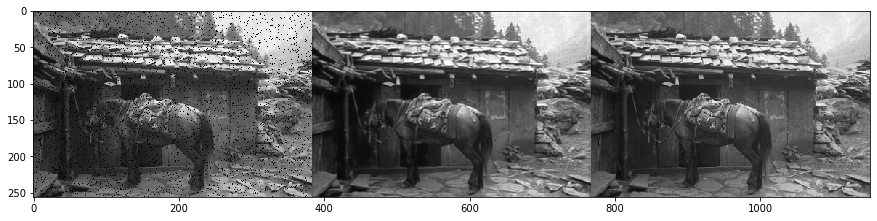

PSNR:  29.55767791336962 

	noisy image				predicted				original


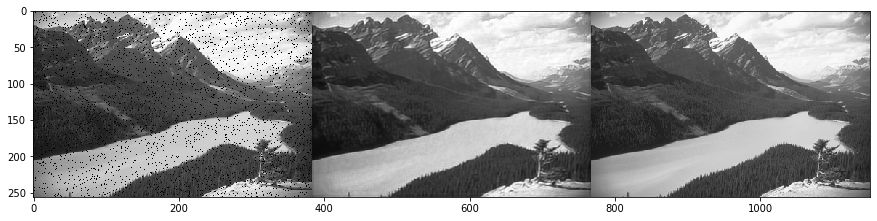

PSNR:  32.31776700427186 

	noisy image				predicted				original


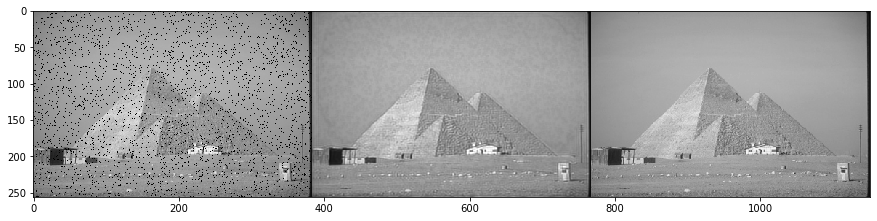

PSNR:  28.52670288555683 

	noisy image				predicted				original


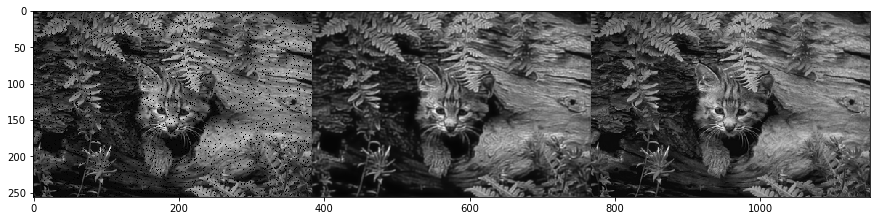

PSNR:  27.492655337568475 

	noisy image				predicted				original


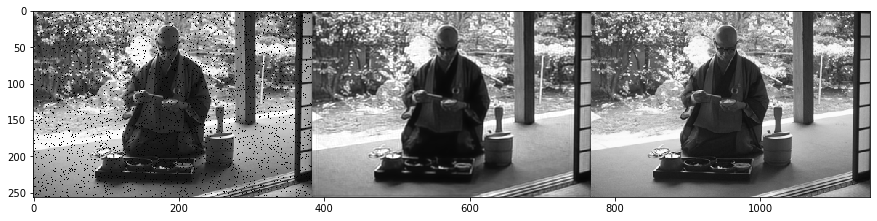

PSNR:  28.68822945636329 

	noisy image				predicted				original


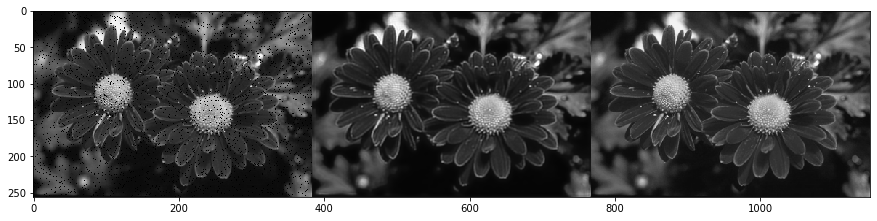

PSNR:  29.54457280283386 

	noisy image				predicted				original


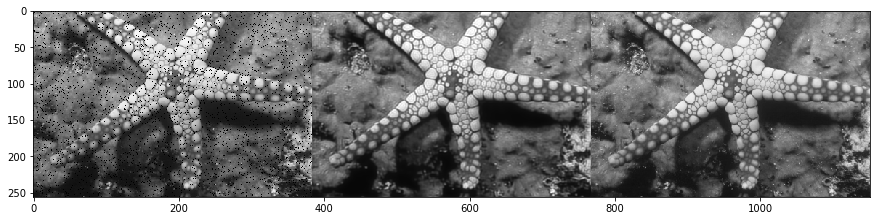

PSNR:  30.94898828054912 

	noisy image				predicted				original


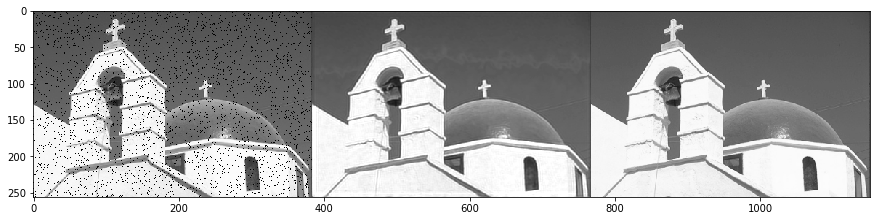

PSNR:  28.094179355564833 

	noisy image				predicted				original


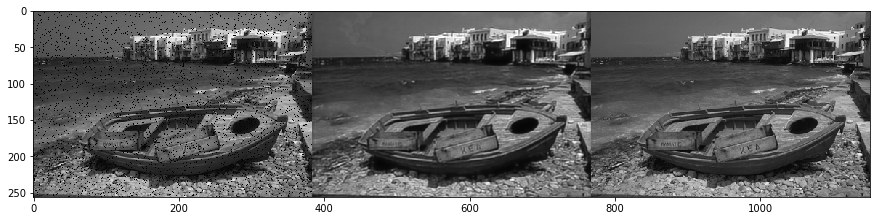

PSNR:  27.45941663420069 

	noisy image				predicted				original


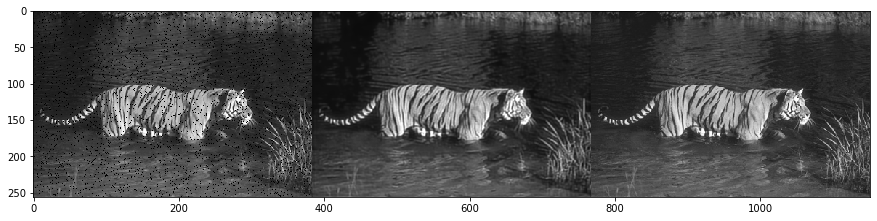

PSNR:  30.15168632228001 

	noisy image				predicted				original


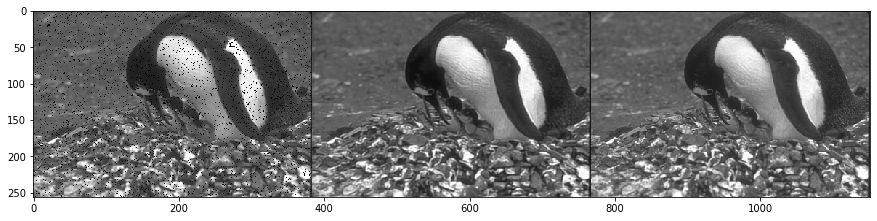

PSNR:  33.82648662684312 

	noisy image				predicted				original


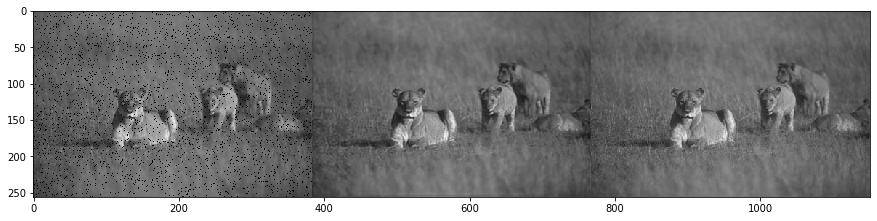

PSNR:  26.549803052146913 

	noisy image				predicted				original


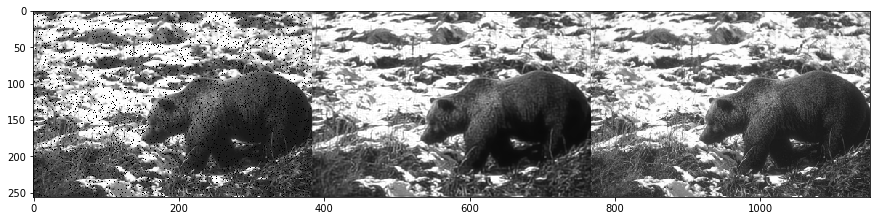

In [55]:
for i in range(len(xtest)):
    tmp = np.expand_dims(xtest[i], axis=0)
    pred = model6.predict(tmp).reshape(256,384)
    stacked1 = np.hstack((xtest[i].reshape(256,384),pred,ytest[i].reshape(256,384)))
    print("PSNR: ",psnr(ytest[i].reshape(256,384),pred),"\n")
    plt.figure(figsize=(15,6))
    print('\tnoisy image\t\t\t\tpredicted\t\t\t\toriginal')
    plt.imshow(stacked1,cmap='gray',vmin=0,vmax=255)
    plt.show()
   

PSNR:  25.157604805261606 

	noisy image				predicted				original


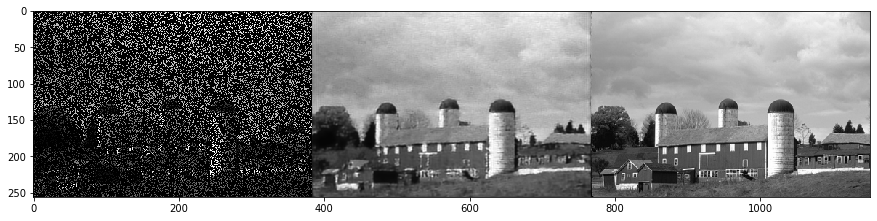

PSNR:  25.013580187007133 

	noisy image				predicted				original


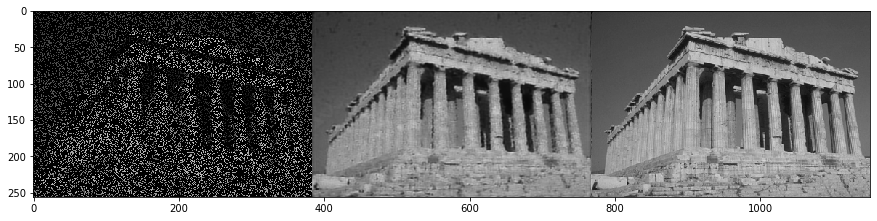

PSNR:  25.339223641905235 

	noisy image				predicted				original


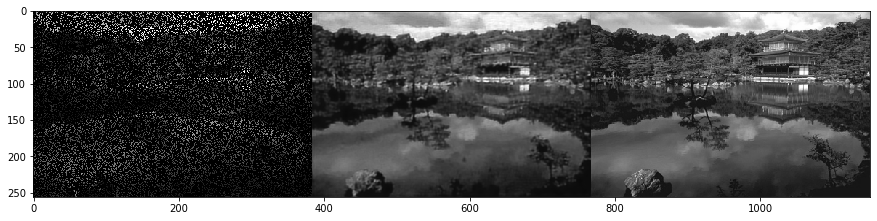

PSNR:  23.646501907088346 

	noisy image				predicted				original


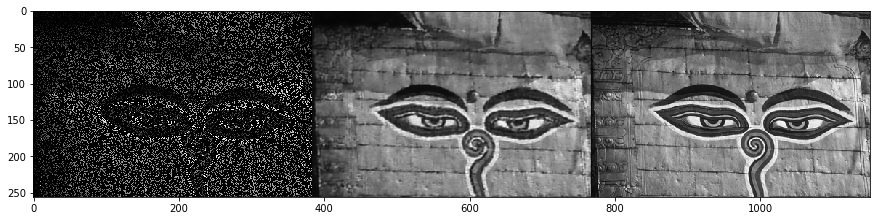

PSNR:  24.369304023583346 

	noisy image				predicted				original


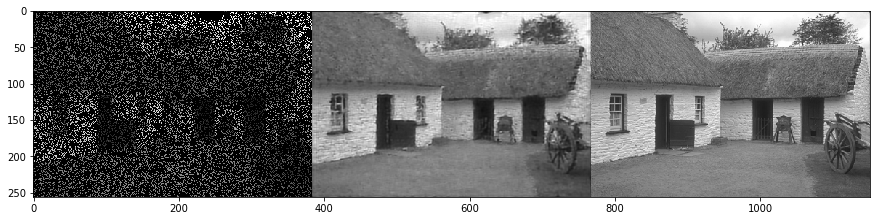

PSNR:  26.172697785131316 

	noisy image				predicted				original


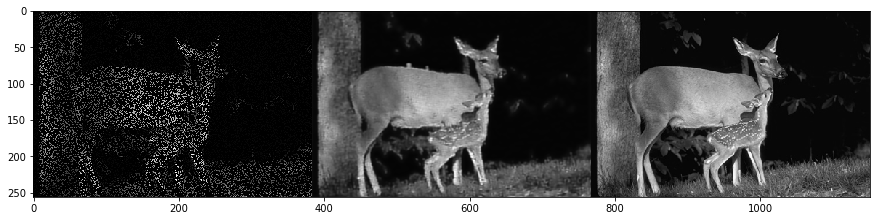

PSNR:  29.91232702041378 

	noisy image				predicted				original


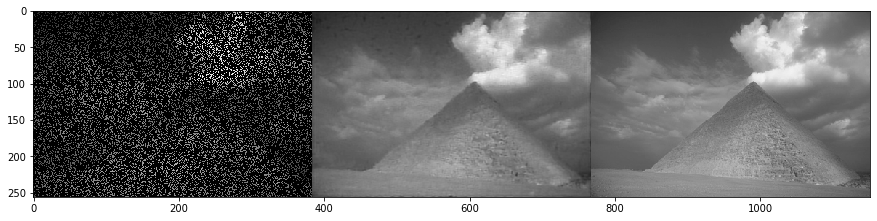

PSNR:  28.27663597531302 

	noisy image				predicted				original


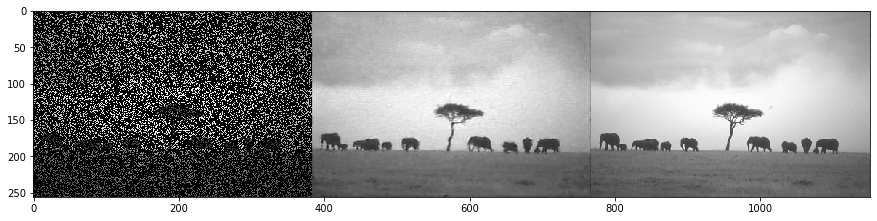

PSNR:  26.930399140088156 

	noisy image				predicted				original


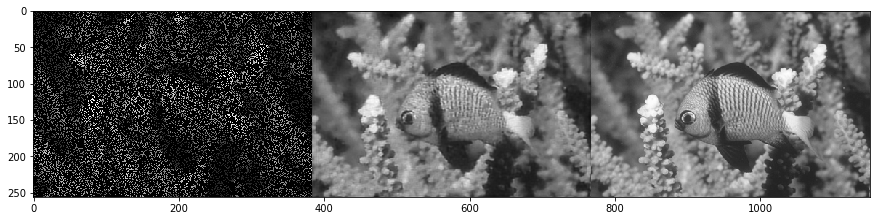

PSNR:  27.399419776592573 

	noisy image				predicted				original


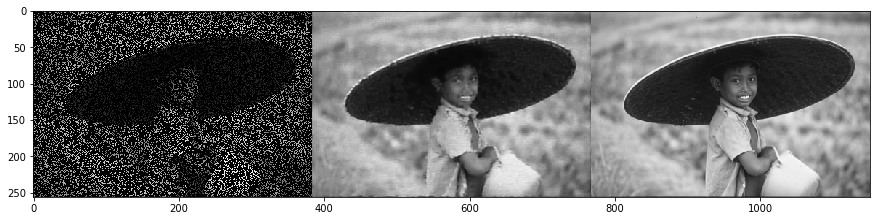

PSNR:  23.73115760822975 

	noisy image				predicted				original


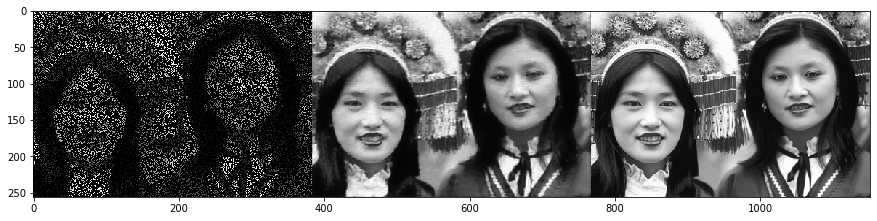

PSNR:  24.324995833724266 

	noisy image				predicted				original


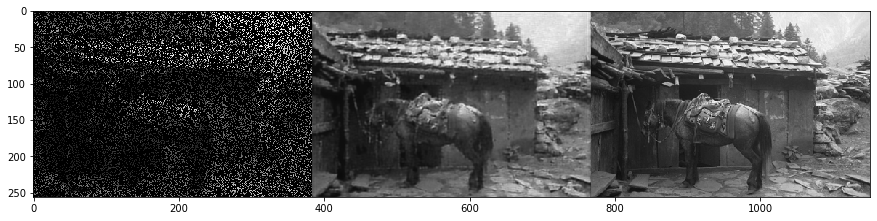

PSNR:  26.435224182195146 

	noisy image				predicted				original


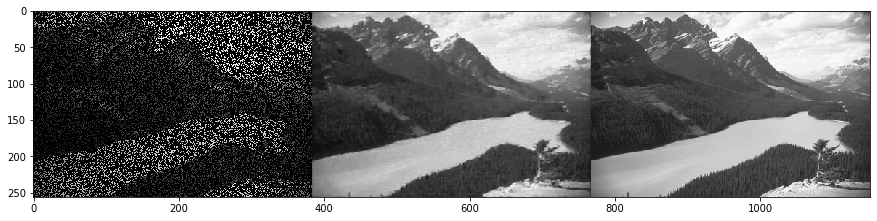

PSNR:  27.295313339912852 

	noisy image				predicted				original


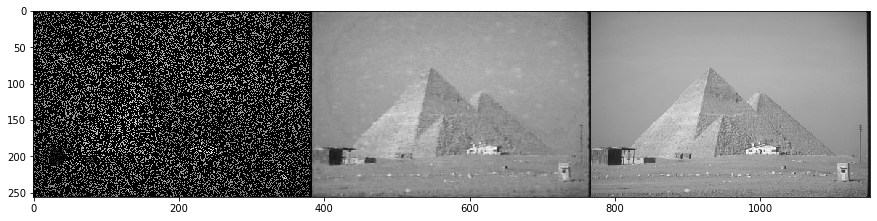

PSNR:  24.517224294043206 

	noisy image				predicted				original


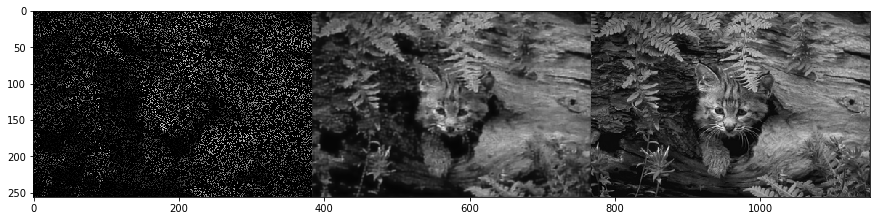

PSNR:  23.062915213338538 

	noisy image				predicted				original


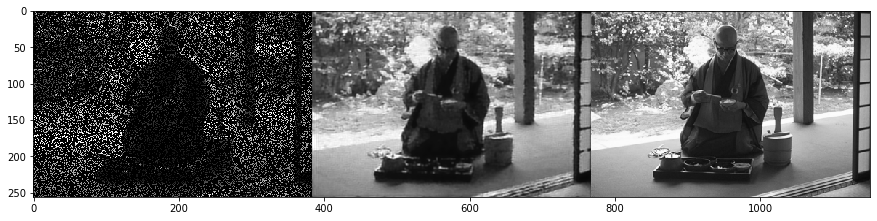

PSNR:  27.41767761685275 

	noisy image				predicted				original


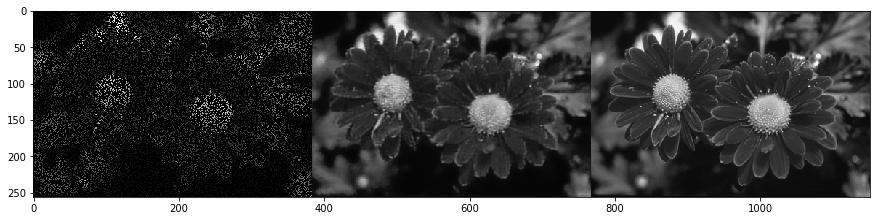

PSNR:  25.824494742861468 

	noisy image				predicted				original


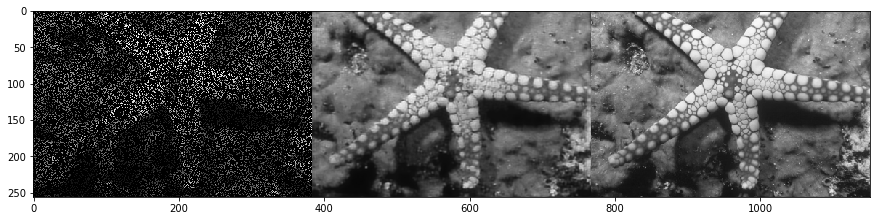

PSNR:  26.670612078243682 

	noisy image				predicted				original


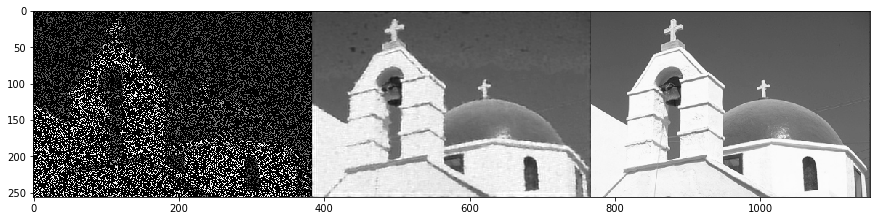

PSNR:  24.324575409676882 

	noisy image				predicted				original


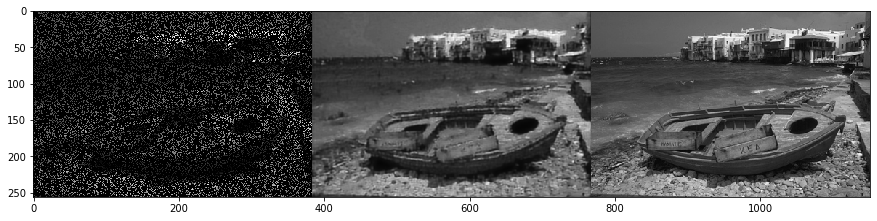

PSNR:  24.915776362244944 

	noisy image				predicted				original


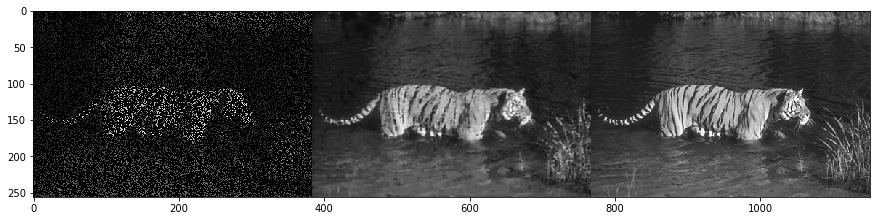

PSNR:  25.644083975716285 

	noisy image				predicted				original


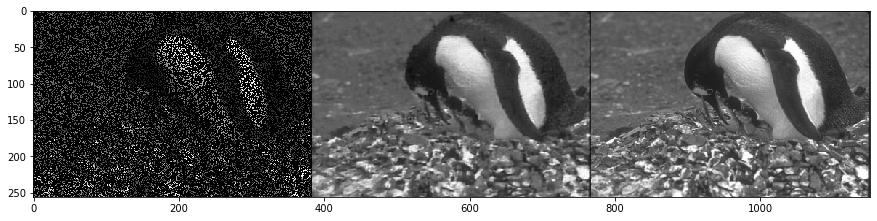

PSNR:  29.97504172987448 

	noisy image				predicted				original


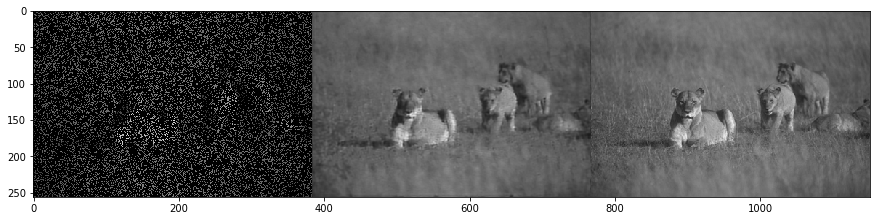

PSNR:  22.330123580697748 

	noisy image				predicted				original


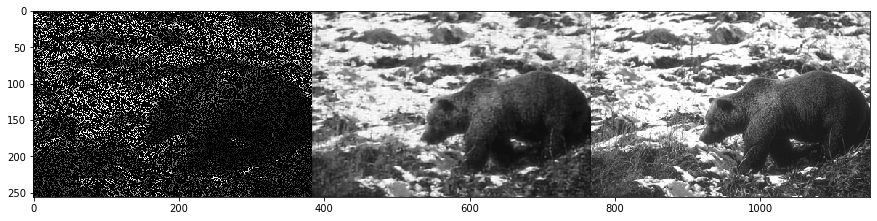

PSNR:  25.75575196448309 

	noisy image				predicted				original


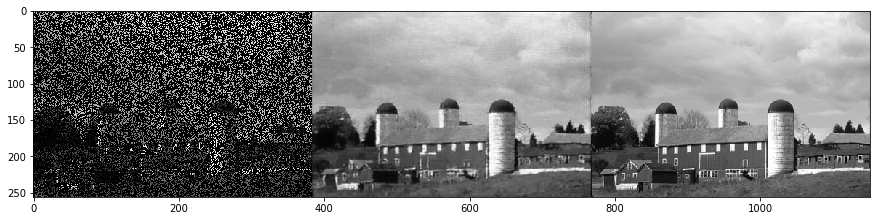

PSNR:  25.314014119624417 

	noisy image				predicted				original


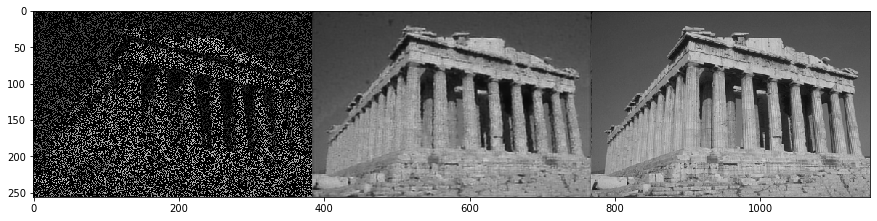

PSNR:  25.968656767359683 

	noisy image				predicted				original


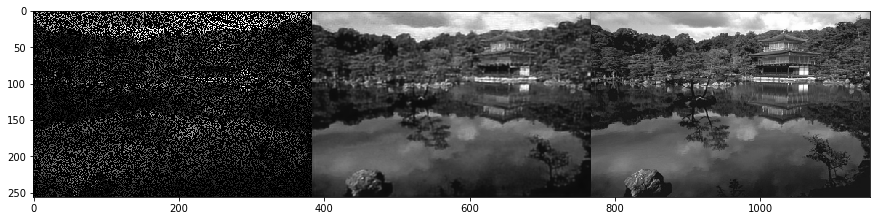

PSNR:  24.128417217662438 

	noisy image				predicted				original


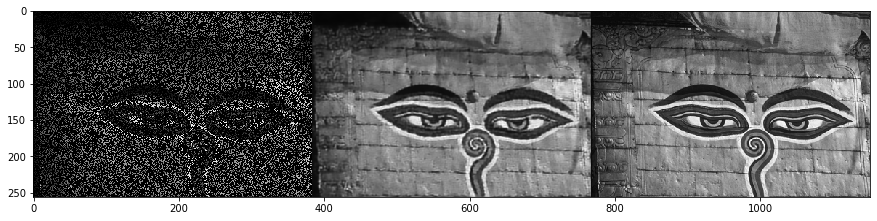

PSNR:  24.75814096819091 

	noisy image				predicted				original


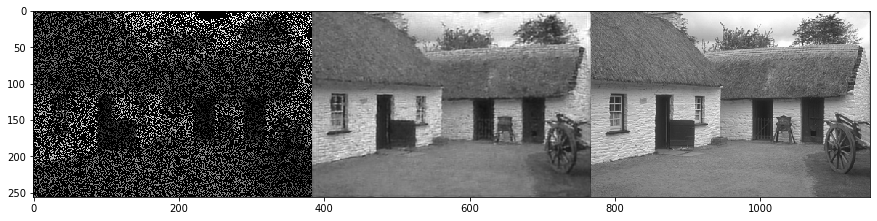

PSNR:  26.917982902820885 

	noisy image				predicted				original


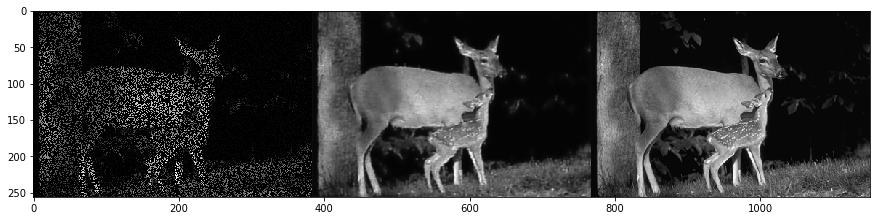

In [56]:
for i in range(len(xtrain[:30])):
    tmp = np.expand_dims(xtrain[i], axis=0)
    pred = model6.predict(tmp).reshape(256,384)
    stacked1 = np.hstack((xtrain[i].reshape(256,384),pred,ytrain[i].reshape(256,384)))
    print("PSNR: ",psnr(ytrain[i].reshape(256,384),pred),"\n")
    plt.figure(figsize=(15,6))
    print('\tnoisy image\t\t\t\tpredicted\t\t\t\toriginal')
    plt.imshow(stacked1,cmap='gray',vmin=0,vmax=255)
    plt.show()
   